# Star Cluster Part I - Aperture Photometry
25.04.08 AstroLab


작성자: Seungwu Yoo, Taewan Kim

## README

본 notebook은 세 가지 종류의 code cell로 구성되어 있습니다.

- [Mission]: 실습을 위해 직접 값을 수정하고 조작해야 하는 부분


- [Auto]: 실습을 위한 필수적으로 조작할 필요는 없으나 이해하기 쉬운 부분


- [Advanced]: 실습을 위한 백그라운드, 필수적으로 이해하고 조작할 필요없이 실행해도 되는 부분

앞으로 천문학을 더 깊게 공부하고 연구하게 될 분들께 [Advanced]를 바칩니다.

### [Auto] Import the package

In [50]:
import numpy as np
import matplotlib.pyplot as plt

import astropy.io.fits as fits
import astropy.units as u
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS

import copy
from astropy.visualization import ZScaleInterval

from astropy.nddata import CCDData, Cutout2D

from astropy.stats import sigma_clipped_stats
from photutils.detection import DAOStarFinder
from photutils.aperture import CircularAperture, CircularAnnulus, ApertureStats

from astropy.coordinates import match_coordinates_sky
import pandas as pd

### [Auto] Adjust rcParams

원하시는 figure 세팅이 있으시면, 해당 cell을 직접 조작하시면 됩니다.

[참고] rcParams이란? 
- runtime configurations parameters, 줄여서 rcparams

- matplotlib을 이용할 때, 원하는 figure의 스타일 (예: 폰트, 축의 두께 등)을 default로 입력하는 하나의 방식

- 한 번 rcparam을 세팅해두면, 커널 (ipynb 파일 하나)를 재실행하기 전까지는 해당 설정이 유지됨

- rcparam을 세팅하지 않고 그래프를 그리는 함수를 쓸 때 원하는 설정값을 직접 입력하는 방법도 있음

- 그래프를 그리는 함수에서 원하는 세팅을 입력할 경우, 그 세팅이 우선됨

- 참조: https://matplotlib.org/stable/users/explain/customizing.html#customizing-with-dynamic-rc-settings

- rcparam setting reference: Taewan Kim

In [114]:
plt.rcParams["font.family"] = 'STIXGeneral'
plt.rcParams['text.usetex'] = False
plt.rcParams["mathtext.fontset"] = 'cm'
plt.rcParams["axes.labelweight"] = "bold"

plt.rcParams.update({'xtick.direction': 'in'})
plt.rcParams.update({'ytick.direction': 'in'})
plt.rcParams.update({'lines.linewidth': 2})
plt.rcParams.update({'xtick.major.pad': 20})
plt.rcParams.update({'ytick.major.pad': 12})
plt.rcParams.update({'image.origin':'lower'})

def ax_largefigure(setting=True):
    if setting:
        plt.rcParams.update({'xtick.major.size': 40})
        plt.rcParams.update({'xtick.minor.size': 20})
        plt.rcParams.update({'ytick.major.size': 40})
        plt.rcParams.update({'ytick.minor.size': 20})
        plt.rcParams.update({'xtick.major.width': 2})
        plt.rcParams.update({'xtick.minor.width': 2})
        plt.rcParams.update({'ytick.major.width': 2})
        plt.rcParams.update({'ytick.minor.width': 2})
        plt.rcParams.update({'font.size': 60})
        plt.rcParams.update({'font.weight': 'normal'})
        plt.rcParams.update({'axes.linewidth': 8})
        plt.rcParams.update({'axes.labelpad': 8})
        plt.rcParams.update({"axes.grid" : True, "grid.color": "black"})
    else:
        plt.rcParams.update({'xtick.major.size': 10})
        plt.rcParams.update({'xtick.minor.size': 5})
        plt.rcParams.update({'ytick.major.size': 10})
        plt.rcParams.update({'ytick.minor.size': 5})
        plt.rcParams.update({'xtick.major.width': 1})
        plt.rcParams.update({'xtick.minor.width': 1})
        plt.rcParams.update({'ytick.major.width': 1})
        plt.rcParams.update({'ytick.minor.width': 1})
        plt.rcParams.update({'font.size': 20})
        plt.rcParams.update({'font.weight': 'normal'})
        plt.rcParams.update({'axes.linewidth': 2})
        plt.rcParams.update({'axes.labelpad': 2})
        plt.rcParams.update({"axes.grid" : False})
        
ax_largefigure()

### Available Data
| Name | RA | DEC | run | camcol | field | Note |
| --- | --- | --- | --- | --- | --- | --- |
| Koposov 36 | 84.218 | 31.210 | 6573 | 6 | 34 | Data in use |
| Czernik 5 | 28.927 | 31.210 | 5959 | 2 | 168 | Provided in file |
| Pfleiderer 3 | 346.995 | 60.874 | 4100 | 5 | 25 | Provided in file |
| Berkeley 49 | 299.872 | 34.643 | 5403 | 6 | 246, 247 | Need Query Yourself |
| Berkeley 84 | 301.170 | 33.906 | 5403 | 6 | 255 | Need Query Yourself |
| Alessi 53 | 97.351 | 9.174 | 7178 | 5 | 220 | Need Query Yourself |

- 혹은 다른 cluster의 데이터를 찾으신 경우, 그것을 사용하셔도 좋습니다

### [Advanced] How to get data from SDSS
- SDSS: Sloan Digital Sky Survey (https://www.sdss.org/)

- 많은 천체의 스펙트럼과 이미지를 제공하는 survey로, 별다른 엑세스 권한 없이 누구나 이용할 수 있게끔 데이터를 제공하고 있다. 

- SDSS는 넓은 영역을 cover하기 위해 'run', 'camcol', 'field'로 구분되는 조각들로 나누어져 있다.

- Python에서 SDSS 데이터를 활용하기 위해 astroquery 패키지를 아래와 같이 활용할 수 있다. 

    - query_region: 주어진 RA, DEC를 중심으로 최대 3arcmin의 반지름 내에 있는 천체를 검색한다. 

    - 천체의 정보는 'ra', 'dec', 'objid', 'run', 'camcol', 'field', 'rerun'으로 제공된다.

    - 이 중 'run', 'camcol', 'rerun'을 이용하여 SDSS의 이미지를 get_images() 함수를 통해 다운받을 수 있다.
    
    - 다운받은 이미지는 fits 파일의 형태로 저장할 수 있다.

In [4]:
from astroquery.sdss import SDSS

coord = SkyCoord(ra=84.218*u.deg, dec=31.210*u.deg)
query = SDSS.query_region(coord, photoobj_fields=['run', 'camcol', 'field'], radius=3*u.arcmin)

print(set(query['run']), set(query['camcol']), set(query['field']))

{6573} {6} {34}


### [Advanced] If query_region doesn't work even if you search the region SDSS covered

- query_region()은 SDSS의 catalog에 있는 천체를 검색하는 함수이다. 만약 cover한 영역에서 SDSS가 천체를 찾아놓지 않았다면 해당 영역을 직접 검색해야 한다. 

- 이를 위해 SQL문법을 직접 사용하여 SDSS에 query를 날릴 수 있다. SQL 문법은 https://en.wikipedia.org/wiki/SQL_syntax 참조 (해당 실습을 위해 필요한 정도는 본 노트북에 있는 정도도 과할 정도로 충분하다)

In [70]:
ra = 84.218
dec = 31.2
radius = 0.1

query = f"""
SELECT run, camcol, field, ra, dec
FROM Field
WHERE ra BETWEEN {ra - radius} AND {ra + radius} AND dec BETWEEN {dec - radius} AND {dec + radius}
"""

res = SDSS.query_sql(query)
print(res)

run  camcol field        ra              dec       
---- ------ ----- ---------------- ----------------
6573      6    34 84.1937272495852 31.2161200456187


run, camcol, field를 입력하여 SDSS에서 image 불러오기

In [92]:
u_dat = SDSS.get_images(camcol=6, field=34, run=6573, rerun=301, band='u')[0]
u_dat.writeto('koposov36_u.fits', overwrite=True)
g_dat = SDSS.get_images(camcol=6, field=34, run=6573, rerun=301, band='g')[0]
g_dat.writeto('koposov36_g.fits', overwrite=True)
r_dat = SDSS.get_images(camcol=6, field=34, run=6573, rerun=301, band='r')[0]
r_dat.writeto('koposov36_r.fits', overwrite=True)
i_dat = SDSS.get_images(camcol=6, field=34, run=6573, rerun=301, band='i')[0]
i_dat.writeto('koposov36_i.fits', overwrite=True)
z_dat = SDSS.get_images(camcol=6, field=34, run=6573, rerun=301, band='z')[0]
z_dat.writeto('koposov36_z.fits', overwrite=True)

astroquery 사용에 어려움을 느낄 경우, 제공된 fits 파일을 직접 다운받아 사용하셔도 됩니다.

In [5]:
u_dat = fits.open('koposov36_u.fits')
g_dat = fits.open('koposov36_g.fits')
r_dat = fits.open('koposov36_r.fits')
i_dat = fits.open('koposov36_i.fits')
z_dat = fits.open('koposov36_z.fits')

### [참고] fits file이란?

- Flexible Image Transport System (FITS) file format은 천문학에서 가장 많이 사용되는 파일 포맷 중 하나로, 이미지와 스펙트럼을 저장하는 데에 사용된다.

- fits파일은 header와 data로 구성되어 있다. 
    - header: fits파일에 대한 메타데이터를 포함하고 있다. 
        - 예를 들어, 이미지의 크기, 단위, 관측 날짜, 관측 기기 정보 등
    - data: 실제 이미지 데이터가 저장되어 있다. 
        - 예를 들어, 각 픽셀의 밝기 값이 저장되어 있다.
    - fits파일은 binary format으로 저장되어 있어, 일반적인 텍스트 편집기로 열 수 없다. 
        - 대신, astropy 패키지의 fits 모듈을 이용하여 읽고 쓸 수 있다.

- fits파일은 복수의 header과 data를 포함할 수 있다. 
    - 예를 들어, 여러 개의 이미지나 스펙트럼을 하나의 fits파일에 저장할 수 있다.
    - 이 경우, 각 header와 data는 HDU (Header Data Unit)라고 불린다.
    - astropy 패키지의 fits 모듈을 이용하여 HDU를 생성하고 조작할 수 있다.

- 본 실습 데이터는 PrimaryHDU의 header와 data를 사용한다.

In [6]:
g_dat.info()

Filename: koposov36_g.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      96   (2048, 1489)   float32   
  1                1 ImageHDU         6   (2048,)   float32   
  2                1 BinTableHDU     27   1R x 3C   [49152E, 2048E, 1489E]   
  3                1 BinTableHDU     79   1R x 31C   [J, 3A, J, A, D, D, 2J, J, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, E, E]   


### [Auto] Check the images

- wcs: https://docs.astropy.org/en/latest/wcs/index.html

    - world coordinate system, fits 파일에 포함된 천체의 RA, DEC를 pixel 좌표로 변환해주는 astropy의 하위 패키지

    - pixel_to_world, world_to_pixel로 실제 RA, DEC좌표와 pixel좌표를 상호 변환할 수 있다

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


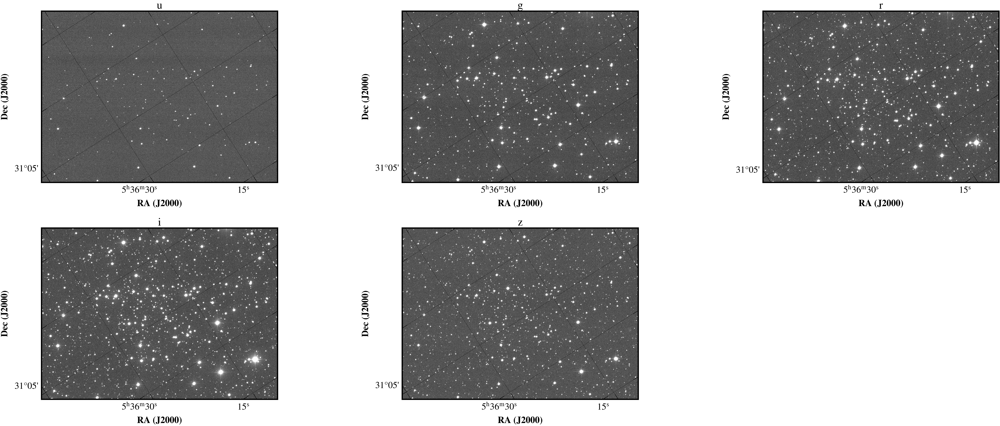

In [7]:
#from matplotlib.patches import Circle
ax_largefigure()

band_data = {'u': u_dat[0].data, 'g': g_dat[0].data, 
               'r': r_dat[0].data, 'i': i_dat[0].data, 'z': z_dat[0].data}
band_header = {'u': u_dat[0].header, 'g': g_dat[0].header, 
                 'r': r_dat[0].header, 'i': i_dat[0].header, 'z': z_dat[0].header}

fig = plt.figure(figsize=(100, 40))
for num, band in enumerate(['u', 'g', 'r', 'i', 'z']):
    wcs = WCS(band_header[band])
    ax = fig.add_subplot(2, 3, num + 1, projection=wcs)
    scaler = ZScaleInterval()
    vmin, vmax = scaler.get_limits(band_data[band])
    ax.imshow(band_data[band], vmin=vmin, vmax=vmax, origin='lower', cmap='gray')
    ax.set_title(band)
    ax.set_xlabel('RA (J2000)')
    ax.set_ylabel('Dec (J2000)')

plt.tight_layout()

### [Mission0] Select the filters

분석에 사용할 filter들을 선택하시기 바랍니다.

In [135]:
used_filters = ['g', 'r', 'i']

### [Mission1] Make masking for the images

Saturation이 의심되는 별을 mask array를 활용하여 data에서 제외하세요. 분석을 반복하면서 mask array를 적절히 수정해볼 필요가 있습니다.

- masking: 이미지에서 특정 영역을 제외하는 작업
    - 하단의 코드에서 data와 똑같은 shape을 가지는 mask를 생성한다. 기본적으로 mask의 모든 값은 False으로 설정되어 있으나, 제외하고자 하는 픽셀 범위는 True로 설정하여 mask array를 생성할 수 있다.
    - 하단의 코드는 mask array가 어떻게 작동하는지 보여주기 위한 예시이다. 

- masking이 필요한 경우 (예시)
    - 분석하고자 하는 천체가 아닌 대상이 이미지에 포함된 경우 (예: 은하 측광 시 근처에 있는 별 등)
    - (본 실습의 경우) Saturated된 star가 있는 경우

In [1]:
'''mask = {'u': np.zeros_like(u_dat[0].data).astype(bool),
        'g': np.zeros_like(g_dat[0].data).astype(bool),
        'r': np.zeros_like(r_dat[0].data).astype(bool),
        'i': np.zeros_like(i_dat[0].data).astype(bool),
        'z': np.zeros_like(z_dat[0].data).astype(bool)}

# You must change the mask to True for the pixels you want to mask

#mask['r'][750:850,900:1020] = True
ax_largefigure()
fig = plt.figure(figsize=(30 * len(used_filters), 20))
for i, band in enumerate(used_filters):
    wcs = WCS(band_header[band])
    ax = fig.add_subplot(1, len(used_filters), i + 1, projection=wcs)
    
    dat = copy.deepcopy(band_data[band])
    mas = copy.deepcopy(mask[band])
    scaler = ZScaleInterval()
    vmin, vmax = scaler.get_limits(dat)
    masked_data = np.ma.array(dat, mask=mas)
    ax.imshow(masked_data, vmin=vmin, vmax=vmax, origin='lower', cmap='gray')
    ax.set_xlabel('RA (J2000)')
    ax.set_ylabel('Dec (J2000)')
    ax.set_title(band)'''

"mask = {'u': np.zeros_like(u_dat[0].data).astype(bool),\n        'g': np.zeros_like(g_dat[0].data).astype(bool),\n        'r': np.zeros_like(r_dat[0].data).astype(bool),\n        'i': np.zeros_like(i_dat[0].data).astype(bool),\n        'z': np.zeros_like(z_dat[0].data).astype(bool)}\n\n# You must change the mask to True for the pixels you want to mask\n\n#mask['r'][750:850,900:1020] = True\nax_largefigure()\nfig = plt.figure(figsize=(30 * len(used_filters), 20))\nfor i, band in enumerate(used_filters):\n    wcs = WCS(band_header[band])\n    ax = fig.add_subplot(1, len(used_filters), i + 1, projection=wcs)\n    \n    dat = copy.deepcopy(band_data[band])\n    mas = copy.deepcopy(mask[band])\n    scaler = ZScaleInterval()\n    vmin, vmax = scaler.get_limits(dat)\n    masked_data = np.ma.array(dat, mask=mas)\n    ax.imshow(masked_data, vmin=vmin, vmax=vmax, origin='lower', cmap='gray')\n    ax.set_xlabel('RA (J2000)')\n    ax.set_ylabel('Dec (J2000)')\n    ax.set_title(band)"

### [Auto] Show how mask array works

In [2]:
'''mask_for_test = np.zeros_like(band_data['g'], dtype=bool)

mask_for_test[750:850,900:1020] = True

ax_largefigure()
fig = plt.figure(figsize=(30, 20))
wcs = WCS(band_header['g'])
ax = fig.add_subplot(1, 1, 1, projection=wcs)
scaler = ZScaleInterval()
vmin, vmax = scaler.get_limits(band_data['g'])
masked_data = np.ma.array(band_data['g'], mask=mask_for_test)
ax.imshow(masked_data, vmin=vmin, vmax=vmax, origin='lower', cmap='gray')
ax.set_xlabel('RA (J2000)')
ax.set_ylabel('Dec (J2000)')'''

"mask_for_test = np.zeros_like(band_data['g'], dtype=bool)\n\nmask_for_test[750:850,900:1020] = True\n\nax_largefigure()\nfig = plt.figure(figsize=(30, 20))\nwcs = WCS(band_header['g'])\nax = fig.add_subplot(1, 1, 1, projection=wcs)\nscaler = ZScaleInterval()\nvmin, vmax = scaler.get_limits(band_data['g'])\nmasked_data = np.ma.array(band_data['g'], mask=mask_for_test)\nax.imshow(masked_data, vmin=vmin, vmax=vmax, origin='lower', cmap='gray')\nax.set_xlabel('RA (J2000)')\nax.set_ylabel('Dec (J2000)')"

### [Mission2] Detect the peak of the signals to find the center of the stars

Threshold와 FWHM을 조정하여 photutils의 DAOStarFinder를 이용하여 별들을 찾으시기 바랍니다.

- DAOStarFinder(Stetson 1987): https://photutils.readthedocs.io/en/stable/api/photutils.detection.DAOStarFinder.html

- DAOStarFinder는 별의 중심을 찾기 위해 Gaussian profile을 사용한다. 
    - Threshold: 별의 중심을 찾기 위한 기준값으로, 이미지 전체의 픽셀값들의 sigma값에 threshold를 곱한 값보다 큰 픽셀을 peak로 찾는다. 
    - FWHM(Full Width Half Maximum): 별의 최소 반지름의 pixel값으로, Peak가 Threshold보다 커도 pixel 반지름이 FWHM보다 작으면 noise로 취급한다. 

- sigma_clipped()
    - sigma_clipped()는 이미지 전체의 표준편차(sigma)의 3배보다 큰 pixel값을 제외하고 평균, 중앙값, 표준편차를 계산하는 함수이다. ('3배'는 바꿀 수 있다.)
    - sigma_clipped()를 사용하는 이유는 이미지에서 별에 의한 신호를 제외한 배경의 통계량을 계산하기 위해서이다. 

In [3]:
'''pos = {}

thres = 10  # Threshold, you should fix this
fwhm = 4    # Full Width at Half Maximum, you should fix this

ax_largefigure()
for i, band in enumerate(used_filters):
    avg, med, std = sigma_clipped_stats(band_data[band]) 
    finder = DAOStarFinder(threshold=thres*std, fwhm=fwhm, exclude_border=True)
    sources = finder(band_data[band] - med, mask=mask[band])
    print()
    sources.pprint(max_lines=10)
    pos[band] = np.transpose((sources['xcentroid'], sources['ycentroid']))

fig = plt.figure(figsize=(30 * len(used_filters), 20))
for i, band in enumerate(used_filters):
    wcs = WCS(band_header[band])
    ax = fig.add_subplot(1, len(used_filters), i + 1, projection=wcs)
    
    dat = copy.deepcopy(band_data[band])
    scaler = ZScaleInterval()
    vmin, vmax = scaler.get_limits(dat)
    # dat.data[mas.astype(bool)] = 0
    ax.imshow(dat, vmin=vmin, vmax=vmax, origin='lower', cmap='gray')
    ax.plot(pos[band][:,0], pos[band][:,1], 'ro', markersize=10)
    ax.set_xlabel('RA (J2000)')
    ax.set_ylabel('Dec (J2000)')
    ax.set_title(band)

plt.tight_layout()
plt.show()'''

"pos = {}\n\nthres = 10  # Threshold, you should fix this\nfwhm = 4    # Full Width at Half Maximum, you should fix this\n\nax_largefigure()\nfor i, band in enumerate(used_filters):\n    avg, med, std = sigma_clipped_stats(band_data[band]) \n    finder = DAOStarFinder(threshold=thres*std, fwhm=fwhm, exclude_border=True)\n    sources = finder(band_data[band] - med, mask=mask[band])\n    print()\n    sources.pprint(max_lines=10)\n    pos[band] = np.transpose((sources['xcentroid'], sources['ycentroid']))\n\nfig = plt.figure(figsize=(30 * len(used_filters), 20))\nfor i, band in enumerate(used_filters):\n    wcs = WCS(band_header[band])\n    ax = fig.add_subplot(1, len(used_filters), i + 1, projection=wcs)\n    \n    dat = copy.deepcopy(band_data[band])\n    scaler = ZScaleInterval()\n    vmin, vmax = scaler.get_limits(dat)\n    # dat.data[mas.astype(bool)] = 0\n    ax.imshow(dat, vmin=vmin, vmax=vmax, origin='lower', cmap='gray')\n    ax.plot(pos[band][:,0], pos[band][:,1], 'ro', markersiz

### [Mission3] Sum the flux within aperture

'Aperture'의 반지름을 조정하여 별들의 flux를 측정하시기 바랍니다.

- CircularAperture: https://photutils.readthedocs.io/en/2.1.0/api/photutils.aperture.CircularAperture.html

- ApertureStats: https://photutils.readthedocs.io/en/stable/api/photutils.aperture.ApertureStats.html
    - ApertureStats는 Aperture 안의 pixel값들의 통계량을 구해주는 함수이다. 
    - ApertureStats의 output은 photutils 패키지에서 정의한 Class type이다. 
    - Class type에 대한 설명: https://docs.python.org/3/tutorial/classes.html

In [4]:
'''rad_aperture = 3 * fwhm # You should check this

apertures = {}

for band in used_filters:
    apertures[band] = CircularAperture(pos[band], r=rad_aperture)

sum_stars = {}

for i, band in enumerate(used_filters):
    starphot = ApertureStats(band_data[band], apertures[band]) 
    sum_stars[band] = starphot.sum
    
ax_largefigure()
fig = plt.figure(figsize=(30 * len(used_filters), 20))
for i, band in enumerate(used_filters):
    wcs = WCS(band_header[band])
    ax = fig.add_subplot(1, len(used_filters), i + 1, projection=wcs)
    
    dat = copy.deepcopy(band_data[band])
    aper = copy.deepcopy(apertures[band])
    scaler = ZScaleInterval()
    vmin, vmax = scaler.get_limits(dat)
    
    ax.imshow(dat, vmin=vmin, vmax=vmax, origin='lower', cmap='gray')
    aper.plot(ax, color='r', alpha=0.5 ,lw=2)
    ax.set_xlabel('RA (J2000)')
    ax.set_ylabel('Dec (J2000)')
    ax.set_title(band)
    
plt.tight_layout()
plt.show()'''

"rad_aperture = 3 * fwhm # You should check this\n\napertures = {}\n\nfor band in used_filters:\n    apertures[band] = CircularAperture(pos[band], r=rad_aperture)\n\nsum_stars = {}\n\nfor i, band in enumerate(used_filters):\n    starphot = ApertureStats(band_data[band], apertures[band]) \n    sum_stars[band] = starphot.sum\n    \nax_largefigure()\nfig = plt.figure(figsize=(30 * len(used_filters), 20))\nfor i, band in enumerate(used_filters):\n    wcs = WCS(band_header[band])\n    ax = fig.add_subplot(1, len(used_filters), i + 1, projection=wcs)\n    \n    dat = copy.deepcopy(band_data[band])\n    aper = copy.deepcopy(apertures[band])\n    scaler = ZScaleInterval()\n    vmin, vmax = scaler.get_limits(dat)\n    \n    ax.imshow(dat, vmin=vmin, vmax=vmax, origin='lower', cmap='gray')\n    aper.plot(ax, color='r', alpha=0.5 ,lw=2)\n    ax.set_xlabel('RA (J2000)')\n    ax.set_ylabel('Dec (J2000)')\n    ax.set_title(band)\n    \nplt.tight_layout()\nplt.show()"

### [Mission4] Figure out the background flux within annulus

'Annulus'의 크기를 조정하여 background flux를 구하시기 바랍니다.
- CircularAnnulus: https://photutils.readthedocs.io/en/stable/api/photutils.aperture.CircularAnnulus.html

- Robust estimation
    - $\rm mode = 2.5 \times median - 1.5 \times mean$ (Bertin & Arnouts (1996))
    - 단순히 mean, 혹은 median을 사용하는 경우 systemical한 오차가 발생할 수 있다.

In [5]:
'''r_in, r_out = 5 * fwhm, 6 * fwhm # You should check this

annuluses = {}

for band in used_filters:
    annuluses[band] = CircularAnnulus(pos[band], r_in=r_in, r_out=r_out)

mode_bkg = {}

for i, band in enumerate(used_filters):
    dat = copy.deepcopy(band_data[band])
    annul = copy.deepcopy(annuluses[band])
    
    bkgphot = ApertureStats(dat, annul) 
    mode_bkg[band] = 2.5*bkgphot.median-1.5*bkgphot.mean # robust estimation

ax_largefigure()
fig = plt.figure(figsize=(30 * len(used_filters), 20))
for i, band in enumerate(used_filters):
    wcs = WCS(band_header[band])
    ax = fig.add_subplot(1, len(used_filters), i + 1, projection=wcs)
    
    dat = copy.deepcopy(band_data[band])
    scaler = ZScaleInterval()
    vmin, vmax = scaler.get_limits(dat)
    # dat.data[mas.astype(bool)] = 0
    ax.imshow(dat, vmin=vmin, vmax=vmax, origin='lower')
    annul.plot(ax, color='b', alpha=0.5 ,lw=2)
    ax.set_xlabel('RA (J2000)')
    ax.set_ylabel('Dec (J2000)')
    ax.set_title(band)

plt.tight_layout()
plt.show()'''

"r_in, r_out = 5 * fwhm, 6 * fwhm # You should check this\n\nannuluses = {}\n\nfor band in used_filters:\n    annuluses[band] = CircularAnnulus(pos[band], r_in=r_in, r_out=r_out)\n\nmode_bkg = {}\n\nfor i, band in enumerate(used_filters):\n    dat = copy.deepcopy(band_data[band])\n    annul = copy.deepcopy(annuluses[band])\n    \n    bkgphot = ApertureStats(dat, annul) \n    mode_bkg[band] = 2.5*bkgphot.median-1.5*bkgphot.mean # robust estimation\n\nax_largefigure()\nfig = plt.figure(figsize=(30 * len(used_filters), 20))\nfor i, band in enumerate(used_filters):\n    wcs = WCS(band_header[band])\n    ax = fig.add_subplot(1, len(used_filters), i + 1, projection=wcs)\n    \n    dat = copy.deepcopy(band_data[band])\n    scaler = ZScaleInterval()\n    vmin, vmax = scaler.get_limits(dat)\n    # dat.data[mas.astype(bool)] = 0\n    ax.imshow(dat, vmin=vmin, vmax=vmax, origin='lower')\n    annul.plot(ax, color='b', alpha=0.5 ,lw=2)\n    ax.set_xlabel('RA (J2000)')\n    ax.set_ylabel('Dec (J2000

### [Auto] Aperture Photometry

- 'Aperture'안에 들어오는 pixel값들의 flux합과 'Annulus'안에 들어오는 pixel값들의 flux합의 차이를 별의 flux로 계산한다.

- $\rm mag = 22.5 - 2.5 \log_{10}(flux)$ 

    - 22.5는 SDSS의 photometric system에서 정의한 zero point이다. 
    
    - magnitude는 AB magnitude system을 따른다. 

    - SDSS photometric system 참고: https://classic.sdss.org/dr7/algorithms/fluxcal.php

In [6]:
'''fluxes = {} 
mags = {} 

for i, band in enumerate(used_filters):
    dat = copy.deepcopy(band_data[band])
    mas = copy.deepcopy(mask[band])
    sums = copy.deepcopy(sum_stars[band])
    aper = copy.deepcopy(apertures[band])
    bkg = copy.deepcopy(mode_bkg[band])
    
    flux = sums-aper.area_overlap(dat, mask=mas)*bkg 
    mag = 22.5 - 2.5 * np.log10(flux)
    fluxes[band] = sums-aper.area_overlap(dat, mask=mas)*bkg
    mags[band] = mag'''

'fluxes = {} \nmags = {} \n\nfor i, band in enumerate(used_filters):\n    dat = copy.deepcopy(band_data[band])\n    mas = copy.deepcopy(mask[band])\n    sums = copy.deepcopy(sum_stars[band])\n    aper = copy.deepcopy(apertures[band])\n    bkg = copy.deepcopy(mode_bkg[band])\n    \n    flux = sums-aper.area_overlap(dat, mask=mas)*bkg \n    mag = 22.5 - 2.5 * np.log10(flux)\n    fluxes[band] = sums-aper.area_overlap(dat, mask=mas)*bkg\n    mags[band] = mag'

### [Mission5] Matching the stars

두 filter에서 각각 찾은 별 사이의 간격 limit (sep_lim)를 설정하여 두 filter의 별을 match하고 등급 table을 저장하시기 바랍니다.

- match_coordinates_sky: https://docs.astropy.org/en/latest/api/astropy.coordinates.match_coordinates_sky.html
    - 천구 상의 두 점 사이의 각거리를 array의 형태로 변환해준다. 

- pandas: https://pandas.pydata.org
    - DataFrame의 형태로 데이터를 가공할 수 있게 해주는 python 패키지

In [7]:
'''sep_lim = 1.5 # You should check this

coord = {}

for band in used_filters:
    coord[band] = WCS(band_header[band]).pixel_to_world(pos[band][:,0], pos[band][:,1])

table_dict = {}

for i in range(len(used_filters)):
    for j in range(i+1, len(used_filters)):
        match_idx, match_angle,_ = match_coordinates_sky(coord[used_filters[i]], 
                                                         coord[used_filters[j]])

        columns=[f'x_{used_filters[i]}', f'y_{used_filters[i]}', 
                f'x_{used_filters[j]}', f'y_{used_filters[j]}', 
                f'ra_{used_filters[i]}', f'dec_{used_filters[i]}', 
                f'ra_{used_filters[j]}', f'dec_{used_filters[j]}', 
                f'mag_{used_filters[i]}', f'mag_{used_filters[j]}']

        table=np.vstack([pos[used_filters[i]][:,0], pos[used_filters[i]][:,1], 
                        pos[used_filters[j]][match_idx,0], pos[used_filters[j]][match_idx,1],
                        coord[used_filters[i]].ra.value, coord[used_filters[i]].dec.value, 
                        coord[used_filters[j]].ra.value[match_idx], 
                        coord[used_filters[j]].dec.value[match_idx],
                        mags[used_filters[i]], mags[used_filters[j]][match_idx]]).T
        table = table[match_angle.to_value('arcsec') < sep_lim,:]

        table = pd.DataFrame(table, columns=columns)
        keyword = f'{used_filters[i]}_{used_filters[j]}'
        table.to_csv(f'koposov36_{keyword}.csv')
        table_dict[keyword] = table'''

"sep_lim = 1.5 # You should check this\n\ncoord = {}\n\nfor band in used_filters:\n    coord[band] = WCS(band_header[band]).pixel_to_world(pos[band][:,0], pos[band][:,1])\n\ntable_dict = {}\n\nfor i in range(len(used_filters)):\n    for j in range(i+1, len(used_filters)):\n        match_idx, match_angle,_ = match_coordinates_sky(coord[used_filters[i]], \n                                                         coord[used_filters[j]])\n\n        columns=[f'x_{used_filters[i]}', f'y_{used_filters[i]}', \n                f'x_{used_filters[j]}', f'y_{used_filters[j]}', \n                f'ra_{used_filters[i]}', f'dec_{used_filters[i]}', \n                f'ra_{used_filters[j]}', f'dec_{used_filters[j]}', \n                f'mag_{used_filters[i]}', f'mag_{used_filters[j]}']\n\n        table=np.vstack([pos[used_filters[i]][:,0], pos[used_filters[i]][:,1], \n                        pos[used_filters[j]][match_idx,0], pos[used_filters[j]][match_idx,1],\n                        coord[used_filter

In [144]:
table_dict['g_r'].head(5)

,x_g,y_g,x_r,y_r,ra_g,dec_g,ra_r,dec_r,mag_g,mag_r
0,1252.351952,15.285963,1248.782851,3.507142,84.097786,31.193098,84.097787,31.193101,19.582877,18.156043
1,662.911377,16.646236,659.447782,4.701242,84.138698,31.138541,84.138697,31.138529,20.932445,19.040868
2,1082.913203,17.443986,1079.400947,5.489902,84.109743,31.177521,84.109727,31.177515,19.973394,18.697421
3,91.005886,17.417743,87.738983,5.584725,84.178288,31.085562,84.178309,31.085561,16.426038,18.328615
4,1682.968322,28.404492,1679.156785,16.726569,84.069398,31.233782,84.069409,31.233780,20.878002,19.996716


### [Auto] Check the matching

In [8]:
'''ax_largefigure(False)

cases = len(used_filters) * (len(used_filters) - 1) // 2
fignum = 1

fig = plt.figure(figsize=(8 * cases, 6))

for i in range(len(used_filters)):
    for j in range(i+1, len(used_filters)):
        table = table_dict[f'{used_filters[i]}_{used_filters[j]}']
        coord = {}
        coord[used_filters[i]] = WCS(band_header[used_filters[i]]).pixel_to_world(table[f'x_{used_filters[i]}'], 
                                                                                  table[f'y_{used_filters[i]}'])
        coord[used_filters[j]] = WCS(band_header[used_filters[j]]).pixel_to_world(table[f'x_{used_filters[j]}'], 
                                                                                  table[f'y_{used_filters[j]}'])
        
        ax = fig.add_subplot(1, cases, fignum)
        ax.minorticks_on()
        ax.plot(coord[used_filters[i]].ra.to_value('arcsec') - 
                coord[used_filters[j]].ra.to_value('arcsec'), 
                coord[used_filters[i]].dec.to_value('arcsec') - 
                coord[used_filters[j]].dec.to_value('arcsec'), 
                '.k', alpha=0.5)
        ax.set_xlabel('$\mathrm{\Delta RA  (arcsec)}$')
        ax.set_ylabel('$\mathrm{\Delta DEC (arcsec)}$')
        fignum += 1
        ax.set_xlim(-1.5, 1.5)
        ax.set_ylim(-1.5, 1.5)

plt.tight_layout()
plt.show()'''

"ax_largefigure(False)\n\ncases = len(used_filters) * (len(used_filters) - 1) // 2\nfignum = 1\n\nfig = plt.figure(figsize=(8 * cases, 6))\n\nfor i in range(len(used_filters)):\n    for j in range(i+1, len(used_filters)):\n        table = table_dict[f'{used_filters[i]}_{used_filters[j]}']\n        coord = {}\n        coord[used_filters[i]] = WCS(band_header[used_filters[i]]).pixel_to_world(table[f'x_{used_filters[i]}'], \n                                                                                  table[f'y_{used_filters[i]}'])\n        coord[used_filters[j]] = WCS(band_header[used_filters[j]]).pixel_to_world(table[f'x_{used_filters[j]}'], \n                                                                                  table[f'y_{used_filters[j]}'])\n        \n        ax = fig.add_subplot(1, cases, fignum)\n        ax.minorticks_on()\n        ax.plot(coord[used_filters[i]].ra.to_value('arcsec') - \n                coord[used_filters[j]].ra.to_value('arcsec'), \n                

### [Auto] Plot the Color-Magnitude-Diagram

In [9]:
'''ax_largefigure(False)

cases = len(used_filters) * (len(used_filters) - 1) // 2
fignum = 1

fig = plt.figure(figsize=(7 * cases, 12))

for i in range(len(used_filters)):
    for j in range(i+1, len(used_filters)):
        ax = fig.add_subplot(1, cases, fignum)
        ax.minorticks_on()
        table = table_dict[f'{used_filters[i]}_{used_filters[j]}']
        ax.scatter(table[f'mag_{used_filters[i]}']-table[f'mag_{used_filters[j]}'], 
                table[f'mag_{used_filters[j]}'], s=1, color='k')
        ax.minorticks_on()
        ax.set_xlabel(f'{used_filters[i]}-{used_filters[j]}')
        ax.set_ylabel(f'{used_filters[j]}')
        ax.set_xlim(-0.5,4.5)
        ax.set_ylim(22,12)

        ax.set_xticks([0, 1, 2, 3, 4])
        fignum += 1
plt.tight_layout()
plt.show()'''

"ax_largefigure(False)\n\ncases = len(used_filters) * (len(used_filters) - 1) // 2\nfignum = 1\n\nfig = plt.figure(figsize=(7 * cases, 12))\n\nfor i in range(len(used_filters)):\n    for j in range(i+1, len(used_filters)):\n        ax = fig.add_subplot(1, cases, fignum)\n        ax.minorticks_on()\n        table = table_dict[f'{used_filters[i]}_{used_filters[j]}']\n        ax.scatter(table[f'mag_{used_filters[i]}']-table[f'mag_{used_filters[j]}'], \n                table[f'mag_{used_filters[j]}'], s=1, color='k')\n        ax.minorticks_on()\n        ax.set_xlabel(f'{used_filters[i]}-{used_filters[j]}')\n        ax.set_ylabel(f'{used_filters[j]}')\n        ax.set_xlim(-0.5,4.5)\n        ax.set_ylim(22,12)\n\n        ax.set_xticks([0, 1, 2, 3, 4])\n        fignum += 1\nplt.tight_layout()\nplt.show()"

### Additional Thinking (Not duty)

- Color-Color Diagram (ex: u-g - g-r)은 어떤 결과를 낼까?

- 우리가 측정한 대상의 flux와 magnitude는 다른 날짜와 다른 고도 등의 다른 환경에서 측정해도 같은 결과가 나올까? 그렇지 않다면 우리는 이를 어떻게 보정할 수 있을까?

- 우리가 분석에 포함한 모든 별이 'Star Cluster'의 별임을 확신할 수 있을까? 그렇지 않다면 우리는 이를 어떻게 보정할 수 있을까?

- Background brightness를 측정한 'robust'한 방법이 또 무엇이 있을까?

- Aperture를 단순히 'Circle'로 가정해도 될까? Circle에서 만족하지 못한다면 우리는 어떤 방식을 취할 수 있을까?

- Open cluster가 아닌 Globular cluster의 경우, 별들이 서로 가까이 붙어있다. 이 경우, 우리는 어떤 방법을 취할 수 있을까?